<a href="https://colab.research.google.com/github/H-Qayyum/Deep-Learning-Project-Garbage-Classification/blob/main/Baseline_Model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=False)
import time
import os
import numpy as np
import torch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data.sampler import SubsetRandomSampler
from sklearn.model_selection import train_test_split
from imutils import paths
import shutil
import torchvision
from torchvision import datasets, models, transforms
import matplotlib.pyplot as plt


Mounted at /content/gdrive


In [ ]:
os.makedirs('/root/dataset')

In [ ]:
!unzip '/content/gdrive/My Drive/Third Year/APS360/balanced_dataset/FinalDataset_balanced.zip' -d '/root/dataset'

Streaming output truncated to the last 5000 lines.
 extracting: /root/dataset/paper/paper_2418.jpg  
 extracting: /root/dataset/paper/augmented_paper134.jpg  
 extracting: /root/dataset/paper/augmented_paper_1466.jpg  
 extracting: /root/dataset/paper/augmented_paper189.jpg  
 extracting: /root/dataset/paper/augmented_paper_2196.jpg  
 extracting: /root/dataset/paper/paper_685.jpg  
 extracting: /root/dataset/paper/paper_3251.jpg  
 extracting: /root/dataset/paper/augmented_paper_1640.jpg  
 extracting: /root/dataset/paper/paper14(1)(1).jpg  
 extracting: /root/dataset/paper/paper102(1)(1).jpg  
 extracting: /root/dataset/paper/paper_2427.jpg  
 extracting: /root/dataset/paper/augmented_paper_2283.jpg  
 extracting: /root/dataset/paper/augmented_paper_2046.jpg  
 extracting: /root/dataset/paper/paper_2195.jpg  
 extracting: /root/dataset/paper/augmented_paper_2940.jpg  
 extracting: /root/dataset/paper/augmented_paper_1728.jpg  
 extracting: /root/dataset/paper/augmented_paper217.jpg  

In [ ]:
import os
from collections import defaultdict
import torchvision.transforms as transforms
from torchvision import datasets
import torch

classes = ['cardboard', 'glass', 'metal', 'paper', 'plastic', 'trash']

dataset_path = '/root/dataset'
class_counts = defaultdict(int)

for className in classes:
    class_folder = os.path.join(dataset_path, className)
    if not os.path.isdir(class_folder):
        continue  # Skip if it's not a directory
    num_images = len([f for f in os.listdir(class_folder) if f.endswith(('.jpg', '.jpeg', '.png', '.ppm', '.bmp', '.pgm', '.tif', '.tiff', '.webp'))])
    class_counts[className] = num_images
    print(f"Number of images in class {className}: {num_images}")


data_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.ToTensor()
])

data = datasets.ImageFolder(dataset_path, transform=data_transform)
train_size = int(0.7 * len(data))
val_size = int(0.15 * len(data))
test_size = len(data) - train_size - val_size

train_dataset, val_dataset, test_dataset = torch.utils.data.random_split(data, [train_size, val_size, test_size])
print()
print("Size of the training dataset is:", len(train_dataset), "images")
print("Size of the validation dataset is:", len(val_dataset), "images")
print("Size of the testing dataset is:", len(test_dataset), "images")
print("Size of the testing dataset is:", len(demo_data), "images")

In [ ]:
# Helper Functions
def get_model_name(name, batch_size, learning_rate, epoch):
    """ Generate a name for the model consisting of all the hyperparameter values

    Args:
        config: Configuration object containing the hyperparameters
    Returns:
        path: A string with the hyperparameter name and value concatenated
    """
    path = "model_{0}_bs{1}_lr{2}_epoch{3}".format(name, batch_size, learning_rate, epoch)
    return path


def get_accuracy(model, data, batch_size):
    predicted_corectly = 0  # Initialize the number of correctly predicted samples
    sample_total = 0    # Initialize the total number of samples

    # Iterate over the data loader in batches
    for images, labels in torch.utils.data.DataLoader(data, batch_size=batch_size):

        output = model(images)  # Forward pass through the model to get predictions

        # Select the index with the maximum prediction score as the predicted class
        prediction = output.max(1, keepdim=True)[1]

        # Compute the number of correctly predicted samples in this batch and add it to the total correct
        predicted_corectly += prediction.eq(labels.view_as(prediction)).sum().item()

        # Increment the total number of samples by the batch size
        sample_total += images.shape[0]

    # Calculate and return the overall accuracy
    x = predicted_corectly / sample_total
    return x

In [ ]:
class EcoSort_CNN(nn.Module):
    def __init__(self):
        super(EcoSort_CNN, self).__init__()
        self.name = "EcoSort"


        # Define the convolutional layers

        self.conv1 = nn.Conv2d(in_channels=3, out_channels=5, kernel_size=5)  #input = 3 RGB, Output = 5 and kernel size of 5x5
        self.conv2 = nn.Conv2d(in_channels=5, out_channels=20, kernel_size=3)   #input = 5, Output = 20 and kernel size of 3x3
        self.conv3 = nn.Conv2d(in_channels=20, out_channels=12, kernel_size=3)   #input = 20 Output = 12 and kernel size of 3x3

         # Define the max pooling layer
        self.pool = nn.MaxPool2d(kernel_size=2, stride=2)   #stride will reduce the resolution by half

         # Define the linear layers
        self.fc1 = nn.Linear(in_features=12 * 26 * 26, out_features=32) #the first linear transformation to have an input size of 12x26x26 (the output size of the second convolutional layer) and an output size of 12.
        self.fc2 = nn.Linear(in_features=32, out_features=6)    #transformation to output size of 6 for 6 garbage classes

    def forward(self, x):
        # Apply first convolution, followed by ReLU activation and max pooling
        x = self.pool(F.relu(self.conv1(x)))

        # Apply second convolution, followed by ReLU activation and max pooling
        x = self.pool(F.relu(self.conv2(x)))
        x = self.pool(F.relu(self.conv3(x)))

        # Flatten the output of the convolutional layers
        x = torch.flatten(x, 1)

        # Apply ReLU activation to the first linear layer
        x = F.relu(self.fc1(x))

        # Apply the second linear layer
        x = self.fc2(x)

        return x


In [ ]:
def train_and_eval(model, train_dataset, val_dataset, batch_size=32, lr=0.001, epochs=30, visualize=True):
    # Check if CUDA is available
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

    # Create data loaders for training and validation datasets
    train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size)
    val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=batch_size)

    # Define loss function and optimizer
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.Adam(model.parameters(), lr=lr)
    torch.manual_seed(1000)

    # Initialize lists to store metrics
    iterations = []
    training_loss = []
    validation_loss = []
    training_accuracy = []
    validation_accuracy = []

    # Start time
    start_time = time.time()

    x=0
    # Training loop
    for epoch in range(epochs):
        model.train()
        running_train_loss = 0.0
        correct_train = 0
        total_train = 0

        # Iterate over training dataset
        for images, labels in train_loader:
            images, labels = images.to(device), labels.to(device)

            # Zero the gradients, forward pass, backward pass, and optimize
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            # Update training loss and accuracy
            running_train_loss += loss.item()
            _, predicted_train = torch.max(outputs, 1)
            total_train += labels.size(0)
            correct_train += (predicted_train == labels).sum().item()

        train_accuracy = correct_train / total_train
        avg_train_loss = running_train_loss / len(train_loader)
        training_loss.append(avg_train_loss)
        training_accuracy.append(train_accuracy)

        # Validation loop
        model.eval()
        running_val_loss = 0.0
        correct_val = 0
        total_val = 0

        # Iterate over validation dataset
        with torch.no_grad():
            for images, labels in val_loader:
                images, labels = images.to(device), labels.to(device)

                # Forward pass
                outputs = model(images)
                loss = criterion(outputs, labels)

                # Update validation loss and accuracy
                running_val_loss += loss.item()
                _, predicted_val = torch.max(outputs, 1)          # the _ is for what the max value is but we only care about where it is ie. which class
                total_val += labels.size(0)
                correct_val += (predicted_val == labels).sum().item()

        val_accuracy = correct_val / total_val
        avg_val_loss = running_val_loss / len(val_loader)
        validation_loss.append(avg_val_loss)
        validation_accuracy.append(val_accuracy)

        iterations.append(epoch + 1)

        x+=1
        if x % 5 == 0:
          model_path = get_model_name(model.name, batch_size, lr, x)
          torch.save(model.state_dict(), model_path)

        # Print training and validation accuracy for each epoch
       #print(f"Epoch {epoch + 1}/{epochs}: Training Loss: {avg_train_loss:.3f} | Training Acc: {train_accuracy:.3f} | Validation Loss: {avg_val_loss:.3f} | Validation Acc: {val_accuracy:.3f}")

        print(f"Epoch {epoch + 1}/{epochs}: Training Accuracy: {train_accuracy:.4f} | Validation Accuracy: {val_accuracy:.4f}")

    # End time
    end_time = time.time()
    total_time = end_time - start_time
    print(f"Total Time: {total_time:.3f} seconds")

    # Visualization
    if visualize:
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.plot(iterations, training_loss, label='Training')
        plt.plot(iterations, validation_loss, label='Validation')
        plt.title('Loss')
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()

        plt.subplot(1, 2, 2)
        plt.plot(iterations, training_accuracy, label='Training')
        plt.plot(iterations, validation_accuracy, label='Validation')
        plt.title('Accuracy')
        plt.xlabel('Epochs')
        plt.ylabel('Accuracy')
        plt.legend()

        plt.tight_layout()
        plt.show()


In [ ]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import torch

class_names = {
    0: 'cardboard',
    1: 'glass',
    2: 'metal',
    3: 'paper',
    4: 'plastic',
    5: 'trash'
}

def confusionMatrix_labels(model, dataset):
    device = next(model.parameters()).device
    data_loader = torch.utils.data.DataLoader(dataset, batch_size=32)

    model.eval()
    true_labels = []
    predicted_labels = []

    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)
            true_labels.extend(labels.numpy())
            predicted_labels.extend(predicted.cpu().numpy())

    conf_matrix = confusion_matrix(true_labels, predicted_labels)

    plt.figure(figsize=(8, 6))
    sns.set(font_scale=1.2)

    # Add class names to the confusion matrix plot
    sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='d', xticklabels=class_names.values(), yticklabels=class_names.values())

    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title('Confusion Matrix')
    plt.show()

    print("Confusion Matrix:")
    print(conf_matrix)


Using device: cuda
Epoch 1/30: Training Accuracy: 0.2577 | Validation Accuracy: 0.3469
Epoch 2/30: Training Accuracy: 0.3610 | Validation Accuracy: 0.3618
Epoch 3/30: Training Accuracy: 0.3998 | Validation Accuracy: 0.4153
Epoch 4/30: Training Accuracy: 0.4280 | Validation Accuracy: 0.4210
Epoch 5/30: Training Accuracy: 0.4490 | Validation Accuracy: 0.4333
Epoch 6/30: Training Accuracy: 0.4568 | Validation Accuracy: 0.4532
Epoch 7/30: Training Accuracy: 0.4651 | Validation Accuracy: 0.4568
Epoch 8/30: Training Accuracy: 0.4668 | Validation Accuracy: 0.4593
Epoch 9/30: Training Accuracy: 0.4762 | Validation Accuracy: 0.4673
Epoch 10/30: Training Accuracy: 0.4858 | Validation Accuracy: 0.4821
Epoch 11/30: Training Accuracy: 0.4873 | Validation Accuracy: 0.4857
Epoch 12/30: Training Accuracy: 0.4936 | Validation Accuracy: 0.4977
Epoch 13/30: Training Accuracy: 0.4937 | Validation Accuracy: 0.4890
Epoch 14/30: Training Accuracy: 0.4985 | Validation Accuracy: 0.4944
Epoch 15/30: Training Ac

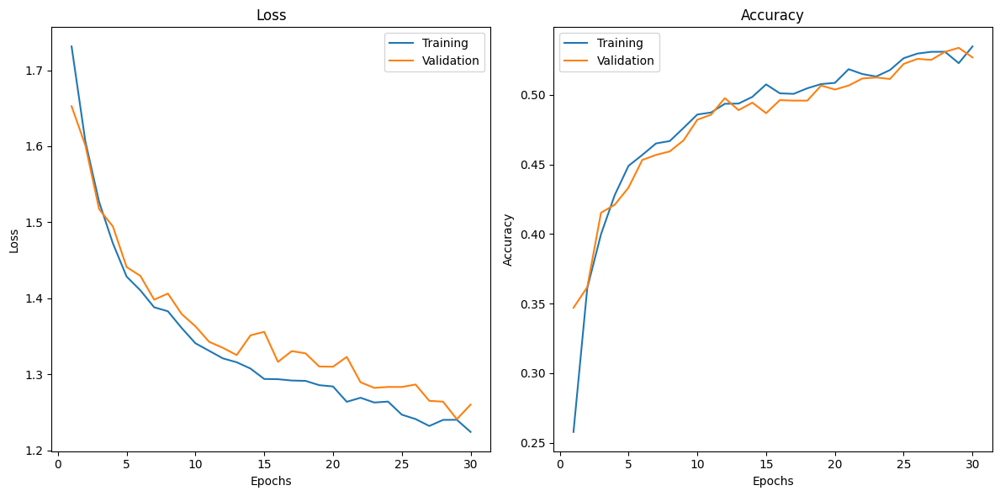

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
baseline_model = EcoSort_CNN().to(device)
print(f"Using device: {device}")

train_and_eval(baseline_model, train_dataset, val_dataset, batch_size=512, lr=0.001, epochs = 30, visualize=True)


In [ ]:
!mv /content/model_EcoSort_bs512_lr0.001_epoch30 /content/gdrive/MyDrive

In [ ]:
#get the best model

best_model_saved = EcoSort_CNN()

best_model_saved.load_state_dict(torch.load('/content/gdrive/MyDrive/model_EcoSort_bs512_lr0.001_epoch30', map_location=torch.device('cpu')))

<All keys matched successfully>

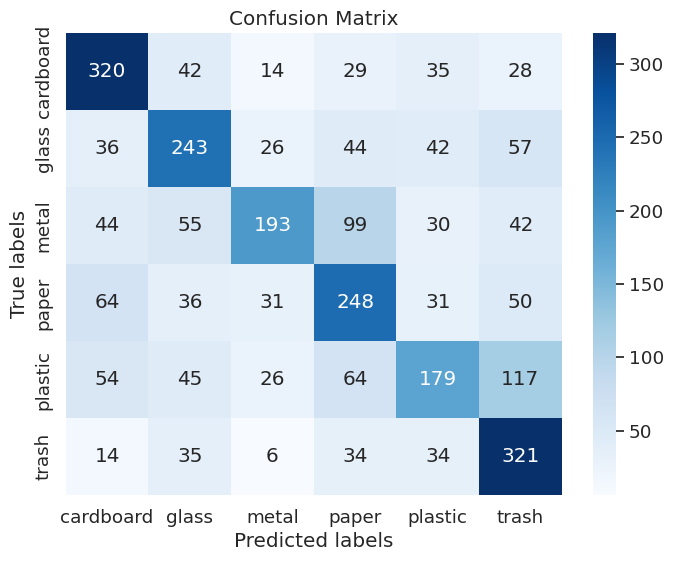

Confusion Matrix:
[[320  42  14  29  35  28]
 [ 36 243  26  44  42  57]
 [ 44  55 193  99  30  42]
 [ 64  36  31 248  31  50]
 [ 54  45  26  64 179 117]
 [ 14  35   6  34  34 321]]


In [ ]:
confusionMatrix_labels(best_model_saved, test_dataset)

Using device: cpu
Epoch 1/30: Training Accuracy: 0.2483 | Validation Accuracy: 0.3162
Epoch 2/30: Training Accuracy: 0.3371 | Validation Accuracy: 0.3650
Epoch 3/30: Training Accuracy: 0.3845 | Validation Accuracy: 0.3816
Epoch 4/30: Training Accuracy: 0.4080 | Validation Accuracy: 0.4116
Epoch 5/30: Training Accuracy: 0.4305 | Validation Accuracy: 0.4492
Epoch 6/30: Training Accuracy: 0.4491 | Validation Accuracy: 0.4489
Epoch 7/30: Training Accuracy: 0.4628 | Validation Accuracy: 0.4658
Epoch 8/30: Training Accuracy: 0.4620 | Validation Accuracy: 0.4691
Epoch 9/30: Training Accuracy: 0.4746 | Validation Accuracy: 0.4637
Epoch 10/30: Training Accuracy: 0.4789 | Validation Accuracy: 0.4868
Epoch 11/30: Training Accuracy: 0.4846 | Validation Accuracy: 0.4973
Epoch 12/30: Training Accuracy: 0.4840 | Validation Accuracy: 0.4958
Epoch 13/30: Training Accuracy: 0.4847 | Validation Accuracy: 0.5027
Epoch 14/30: Training Accuracy: 0.4945 | Validation Accuracy: 0.4868
Epoch 15/30: Training Acc

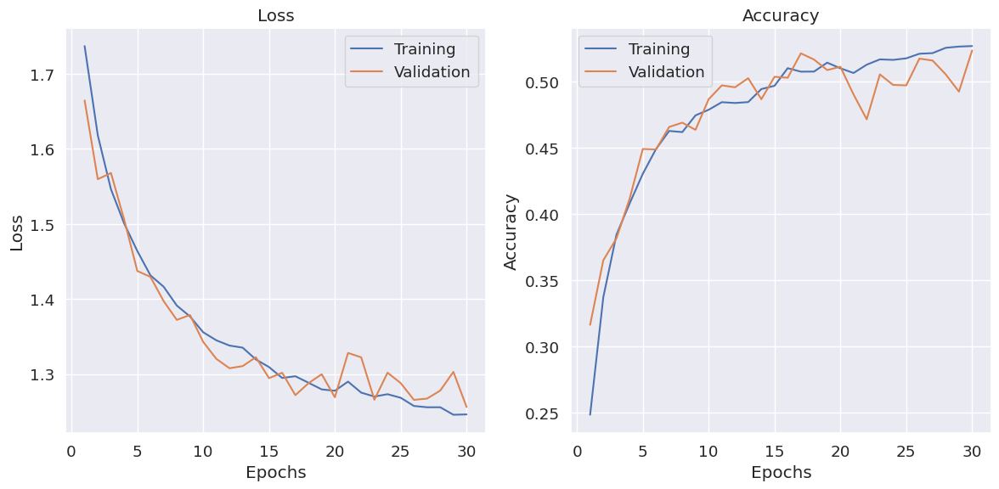

In [ ]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
baseline_model_two = EcoSort_CNN().to(device)
print(f"Using device: {device}")

train_and_eval(baseline_model_two, train_dataset, val_dataset, batch_size=128, lr=0.001, epochs = 30, visualize=True)

In [ ]:
# confusion Matrix!!!
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import torch


    # Assuming you have your test dataset and model ready
def confusionMatrix(model, dataset):
    device = next(model.parameters()).device

    data = torch.utils.data.DataLoader(dataset, batch_size=32) #this saved my life - HQ
    model.eval()
    true_labels = []
    predicted_labels = []

    # Iterate over the test dataset to get predictions
    for inputs, labels in data:
        outputs = model(inputs)               # Forward pass
        _, predicted = torch.max(outputs, 1)        # Get the predicted class
        true_labels.extend(labels.numpy())          # Convert labels tensor to numpy array and append
        predicted_labels.extend(predicted.numpy())  # Convert predicted tensor to numpy array and append

    # Calculate and print confusion matrix
    conf_matrix = confusion_matrix(true_labels, predicted_labels)
    # Define class labels (optional)
    class_names = ['1', '2', '3', '4', '5', '6']  # Replace with your class names

    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    sns.set(font_scale=1.2)  # Adjust font size

    # Create a heatmap with annotations and color bar
    sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='d', xticklabels=class_names, yticklabels=class_names)

    # Add labels and title
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title('Confusion Matrix')

    # Show the plot
    plt.show()
    print("Confusion Matrix:")
    print(conf_matrix)


In [ ]:
#to use if GPU was used


def confusionMatrix2(model, dataset):
    device = next(model.parameters()).device  # Get the device of the model's parameters
    data_loader = torch.utils.data.DataLoader(dataset, batch_size=32)

    model.eval()
    true_labels = []
    predicted_labels = []

    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs = inputs.to(device)  # Move inputs to the same device as the model
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)
            true_labels.extend(labels.numpy())
            predicted_labels.extend(predicted.cpu().numpy())  # Move predicted to CPU for numpy conversion

    conf_matrix = confusion_matrix(true_labels, predicted_labels)
    class_names = ['1', '2', '3', '4', '5', '6']

    plt.figure(figsize=(8, 6))
    sns.set(font_scale=1.2)

    sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='d', xticklabels=class_names, yticklabels=class_names)
    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title('Confusion Matrix')
    plt.show()

    print("Confusion Matrix:")
    print(conf_matrix)

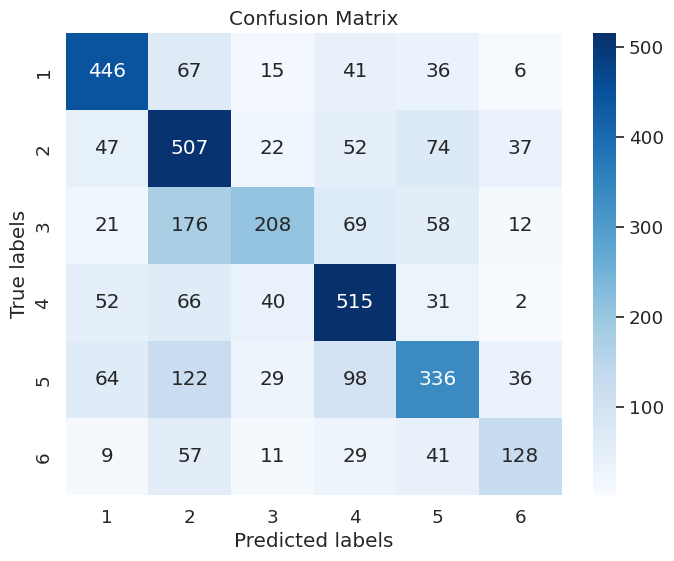

Confusion Matrix:
[[446  67  15  41  36   6]
 [ 47 507  22  52  74  37]
 [ 21 176 208  69  58  12]
 [ 52  66  40 515  31   2]
 [ 64 122  29  98 336  36]
 [  9  57  11  29  41 128]]


In [ ]:
confusionMatrix2(baseline_model_two, val_dataset)

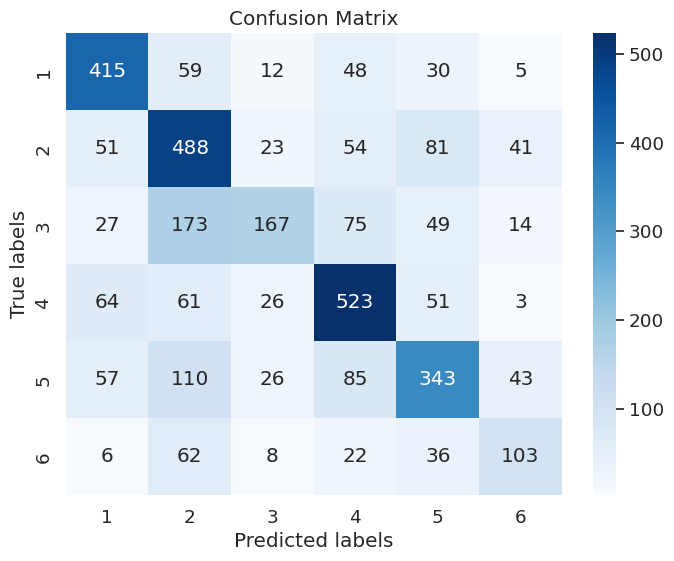

Confusion Matrix:
[[415  59  12  48  30   5]
 [ 51 488  23  54  81  41]
 [ 27 173 167  75  49  14]
 [ 64  61  26 523  51   3]
 [ 57 110  26  85 343  43]
 [  6  62   8  22  36 103]]


In [ ]:
confusionMatrix2(baseline_model_two, test_dataset)

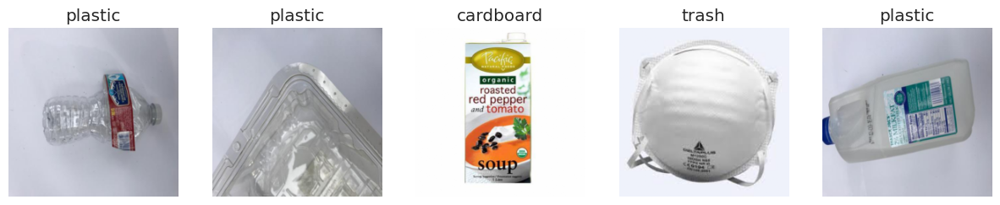

Class-to-index mapping:
{'cardboard': 0, 'glass': 1, 'metal': 2, 'paper': 3, 'plastic': 4, 'trash': 5}

Index-to-class mapping:
{0: 'cardboard', 1: 'glass', 2: 'metal', 3: 'paper', 4: 'plastic', 5: 'trash'}


In [ ]:
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from torchvision import datasets

# Define the path to your dataset
#FinalDataset = "path_to_your_dataset"

# Define the transformation to apply to the images
data_transform = transforms.Compose([
    transforms.Resize((224, 224)),  # Resize images to 224x224
    transforms.ToTensor()           # Convert images to tensors
])

# Load the dataset
data = datasets.ImageFolder(FinalDataset, transform=data_transform)

# Get the class-to-index mapping
class_to_idx = data.class_to_idx

# Define the reverse mapping from index to class
idx_to_class = {v: k for k, v in class_to_idx.items()}

# Load a subset of the dataset (e.g., the first few images)
subset_loader = torch.utils.data.DataLoader(data, batch_size=5, shuffle=True)
images, labels = next(iter(subset_loader))

# Define class names
class_names = ['cardboard', 'glass', 'metal', 'paper', 'plastic', 'trash']

# Visualize the subset of images
plt.figure(figsize=(15, 10))
for i in range(len(images)):
    image = images[i].permute(1, 2, 0)  # Rearrange dimensions for visualization
    plt.subplot(1, len(images), i + 1)
    plt.imshow(image)
    plt.title(class_names[labels[i].item()])  # Use the label as the title
    plt.axis('off')
plt.show()

# Verify the mapping between class indices and folder names
print("Class-to-index mapping:")
print(class_to_idx)
print("\nIndex-to-class mapping:")
print(idx_to_class)


In [ ]:
class_names = {
    0: 'cardboard',
    1: 'glass',
    2: 'metal',
    3: 'paper',
    4: 'plastic',
    5: 'trash'
}

In [ ]:
def confusionMatrix_labels(model, dataset):
    device = next(model.parameters()).device
    data_loader = torch.utils.data.DataLoader(dataset, batch_size=32)

    model.eval()
    true_labels = []
    predicted_labels = []

    with torch.no_grad():
        for inputs, labels in data_loader:
            inputs = inputs.to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs, 1)
            true_labels.extend(labels.numpy())
            predicted_labels.extend(predicted.cpu().numpy())

    conf_matrix = confusion_matrix(true_labels, predicted_labels)

    plt.figure(figsize=(8, 6))
    sns.set(font_scale=1.2)

    # Add class names to the confusion matrix plot
    sns.heatmap(conf_matrix, annot=True, cmap='Blues', fmt='d', xticklabels=class_names.values(), yticklabels=class_names.values())

    plt.xlabel('Predicted labels')
    plt.ylabel('True labels')
    plt.title('Confusion Matrix')
    plt.show()

    print("Confusion Matrix:")
    print(conf_matrix)


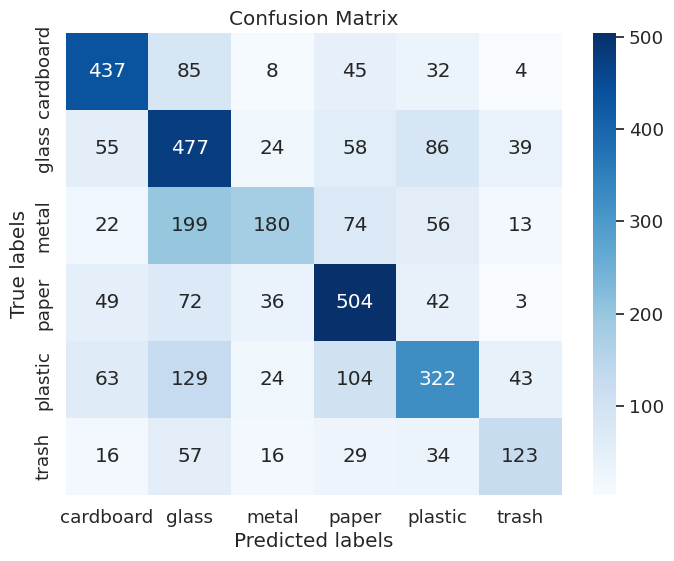

Confusion Matrix:
[[437  85   8  45  32   4]
 [ 55 477  24  58  86  39]
 [ 22 199 180  74  56  13]
 [ 49  72  36 504  42   3]
 [ 63 129  24 104 322  43]
 [ 16  57  16  29  34 123]]


In [ ]:
confusionMatrix_labels(baseline_model_two, val_dataset)

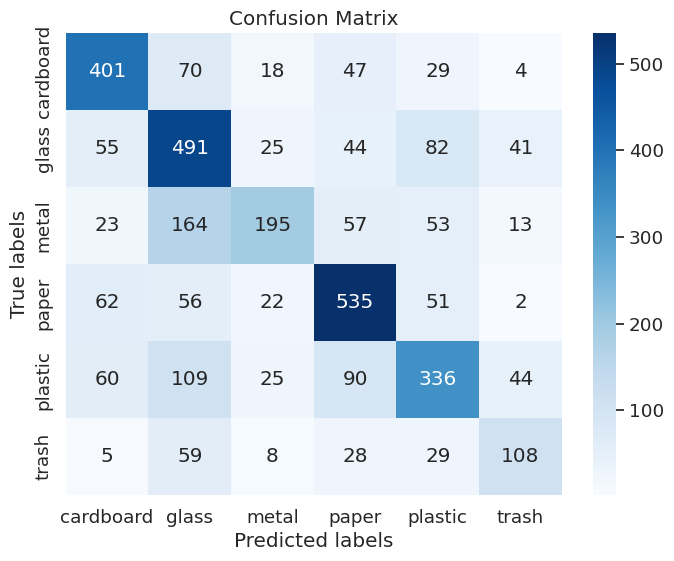

Confusion Matrix:
[[401  70  18  47  29   4]
 [ 55 491  25  44  82  41]
 [ 23 164 195  57  53  13]
 [ 62  56  22 535  51   2]
 [ 60 109  25  90 336  44]
 [  5  59   8  28  29 108]]


In [ ]:
confusionMatrix_labels(baseline_model_two, test_dataset)

In [ ]:
def plot_predicted_images(model, dataset, class_names, num_images=10):
    data_loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True)
    device = next(model.parameters()).device

    model.eval()
    for i, (inputs, labels) in enumerate(data_loader):
        if i >= num_images:
            break
        inputs = inputs.to(device)
        outputs = model(inputs)
        _, predicted = torch.max(outputs, 1)
        predicted_class = predicted.item()
        true_class = labels.item()

        # Convert tensors to numpy arrays for visualization
        image = inputs.squeeze().cpu().numpy().transpose(1, 2, 0)
        image = np.clip(image, 0, 1)  # Clip to [0, 1] range

        # Display the image along with predicted and true labels
        plt.figure()
        plt.imshow(image)
        plt.axis('off')
        plt.title(f'Predicted: {class_names[predicted_class]}, True: {class_names[true_class]}')
        plt.show()



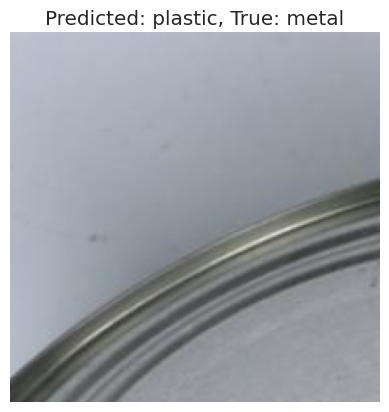

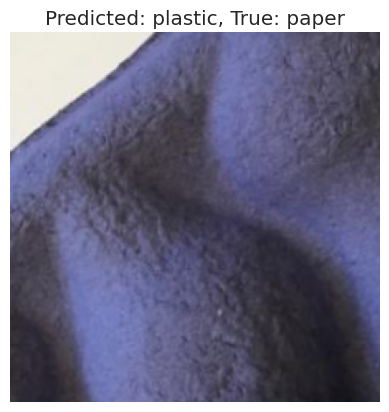

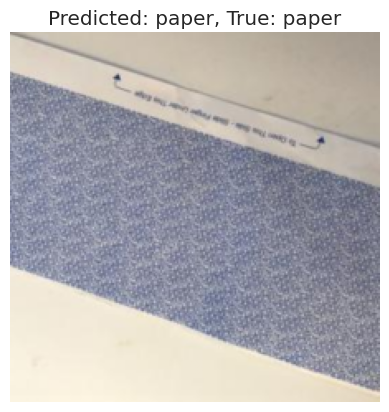

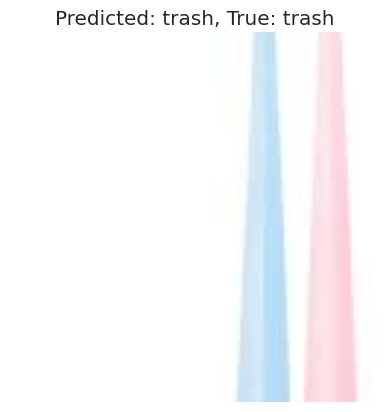

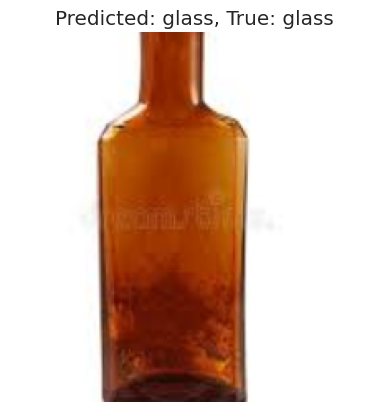

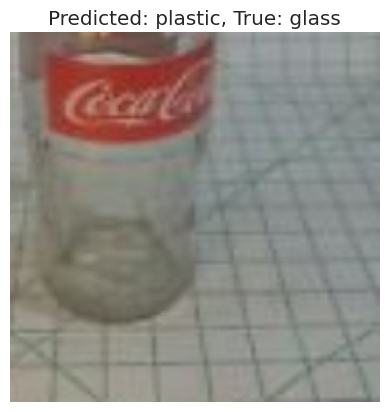

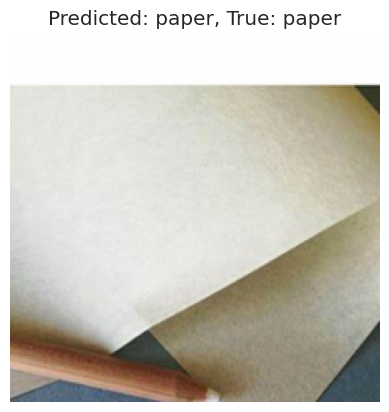

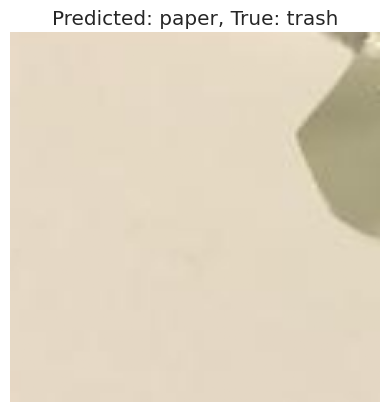

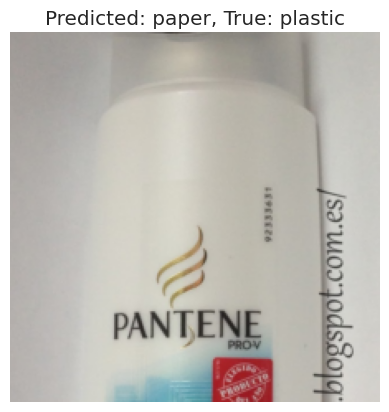

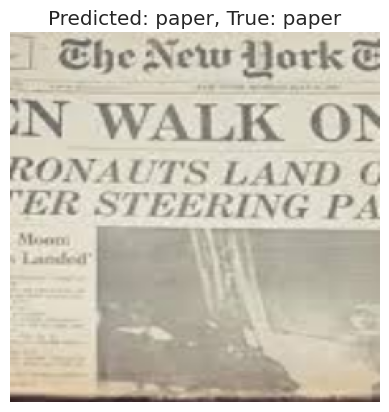

In [ ]:
plot_predicted_images(baseline_model_two, test_dataset, class_names)

In [ ]:
import math

def plot_predicted_images_grid(model, dataset, class_names, num_images=5):
    data_loader = torch.utils.data.DataLoader(dataset, batch_size=1, shuffle=True)
    device = next(model.parameters()).device

    model.eval()
    num_rows = math.ceil(num_images / 3)
    fig, axs = plt.subplots(num_rows, 3, figsize=(15, 5*num_rows))
    for i, (inputs, labels) in enumerate(data_loader):
        if i >= num_images:
            break
        inputs = inputs.to(device)
        outputs = model(inputs)
        _, predicted = torch.max(outputs, 1)
        predicted_class = predicted.item()
        true_class = labels.item()

        # Convert tensors to numpy arrays for visualization
        image = inputs.squeeze().cpu().numpy().transpose(1, 2, 0)
        image = np.clip(image, 0, 1)  # Clip to [0, 1] range

        # Display the image along with predicted and true labels
        row = i // 3
        col = i % 3
        axs[row, col].imshow(image)
        axs[row, col].axis('off')
        axs[row, col].set_title(f'Predicted: {class_names[predicted_class]}, True: {class_names[true_class]}')

    plt.tight_layout()
    plt.show()



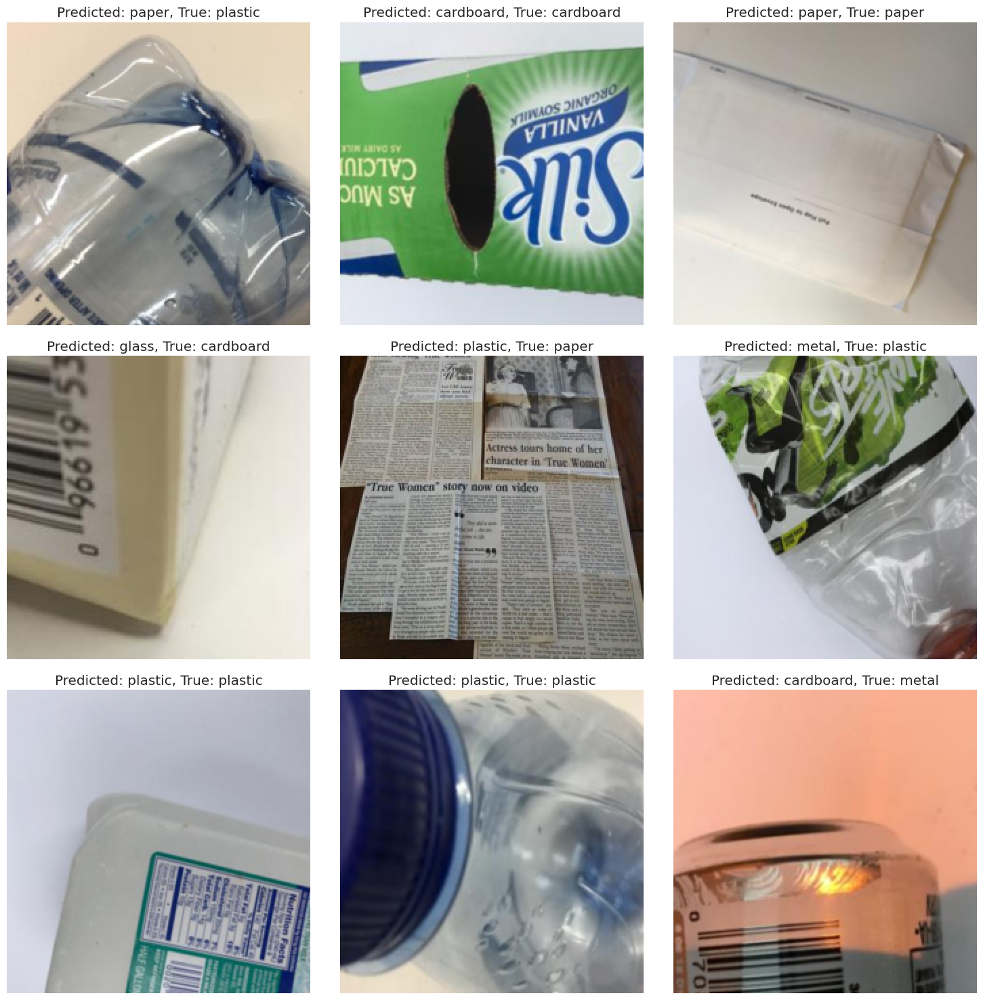

In [ ]:
plot_predicted_images_grid(baseline_model_two, val_dataset, class_names, num_images=9)

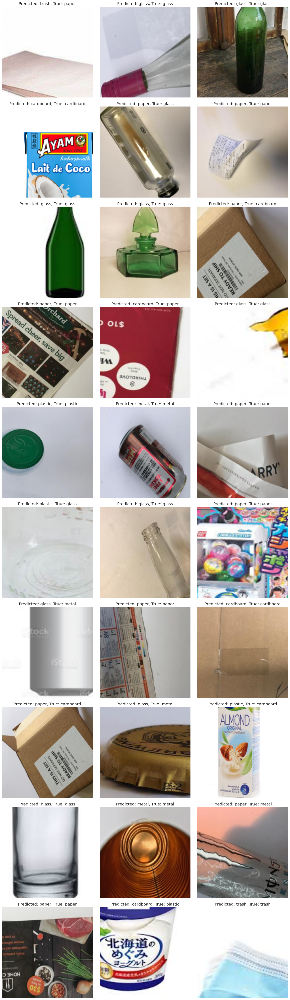

In [ ]:
plot_predicted_images_grid(baseline_model_two, test_dataset, class_names, num_images=30)

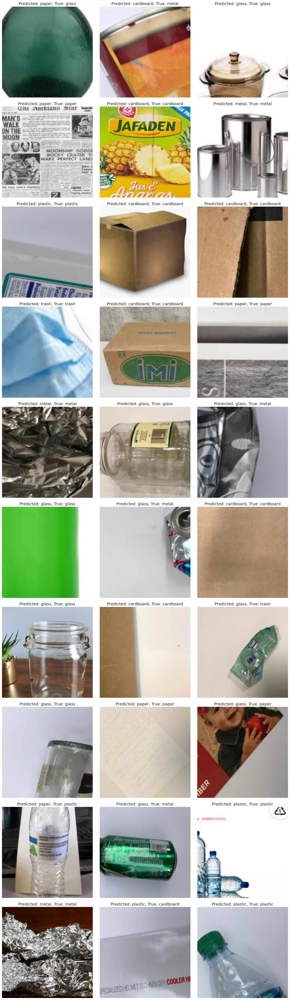

In [ ]:
plot_predicted_images_grid(baseline_model_two, val_dataset, class_names, num_images=30)

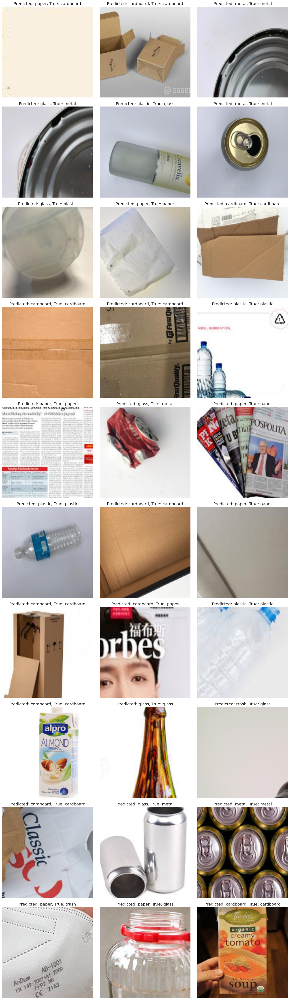

In [ ]:
plot_predicted_images_grid(baseline_model_two, test_dataset, class_names, num_images=30)

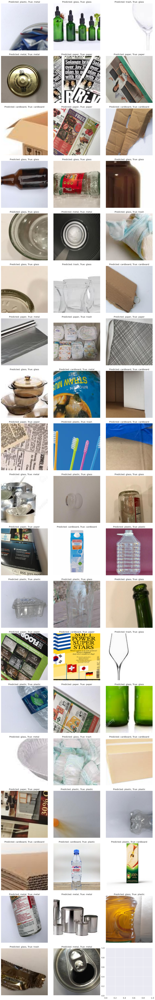

In [ ]:
plot_predicted_images_grid(baseline_model_two, val_dataset, class_names, num_images=56)

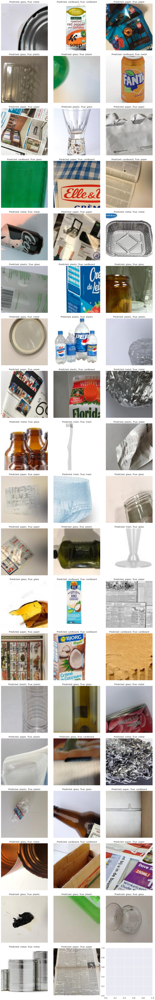

In [ ]:
plot_predicted_images_grid(baseline_model_two, test_dataset, class_names, num_images=56)

In [ ]:
#get the best model

model = EcoSort_CNN()

model.load_state_dict(torch.load('/content/gdrive/MyDrive/model_EcoSort_bs512_lr0.001_epoch30', map_location=torch.device('cpu')))

<All keys matched successfully>

In [ ]:
import os
from collections import defaultdict
import torchvision.transforms as transforms
from torchvision import datasets
import torch

classes = ['cardboard', 'glass', 'metal', 'paper', 'plastic', 'trash']

dataset_path = '/root/dataset'
class_counts = defaultdict(int)

for className in classes:
    class_folder = os.path.join(dataset_path, className)
    if not os.path.isdir(class_folder):
        continue  # Skip if it's not a directory
    num_images = len([f for f in os.listdir(class_folder) if f.endswith(('.jpg', '.jpeg', '.png', '.ppm', '.bmp', '.pgm', '.tif', '.tiff', '.webp'))])
    class_counts[className] = num_images
    print(f"Number of images in class {className}: {num_images}")


data_transform = transforms.Compose([
    transforms.RandomResizedCrop(224),
    transforms.ToTensor()
])

data = datasets.ImageFolder(dataset_path, transform=data_transform)
train_size = int(0.7 * len(data))
val_size = int(0.15 * len(data))
demo = int(0.0001 * len(data))
test_size = len(data) - train_size - val_size - demo

train_dataset, val_dataset, test_dataset, demo_data = torch.utils.data.random_split(data, [train_size, val_size, test_size, demo])
print()
print("Size of the training dataset is:", len(train_dataset), "images")
print("Size of the validation dataset is:", len(val_dataset), "images")
print("Size of the testing dataset is:", len(test_dataset), "images")
print("Size of the testing dataset is:", len(demo_data), "images")

Number of images in class cardboard: 3075
Number of images in class glass: 3075
Number of images in class metal: 3075
Number of images in class paper: 3074
Number of images in class plastic: 3075
Number of images in class trash: 3075

Size of the training dataset is: 12914 images
Size of the validation dataset is: 2767 images
Size of the testing dataset is: 2767 images
Size of the testing dataset is: 1 images


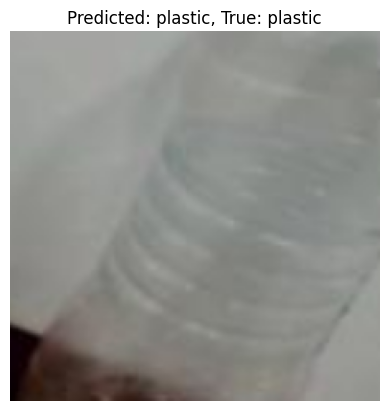

In [ ]:
plot_predicted_images(model, demo_data, class_names)